# Modeling 2D reaction-diffusion systems using image filters

Image analysis packages like `scikit-image` can be useful for modeling spatial systems.

In [1]:
%matplotlib inline
import numpy as np
import skimage as ski
import skimage.filters
import matplotlib.pyplot as plt
plt.rcParams["animation.html"] = "jshtml"
import seaborn as sns; sns.set_style('white'); sns.set_context('talk')
from celluloid import Camera

# Model 1
## Diffusive System with Local Excitation-Long Range Inhibition

In [2]:
N = 50 #number of time steps
a = 5 #excitation radius
b = 10 #inhibition radius
beta = 10 #steepness of interaction

In [3]:
np.random.seed(0)
pic = ((np.random.rand(300,300,N)-0.5)*2)*0.01

A difference of gaussians approximates a mexican hat.

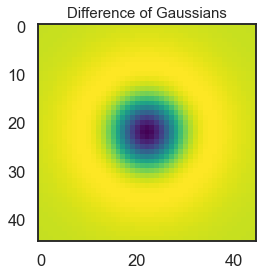

In [4]:
cen=int(np.round(1.5*(a+b))); siz=(2*cen+1)
gauss1 = np.zeros([siz,siz]); gauss1[cen,cen]=1.0; gauss1 = ski.filters.gaussian(gauss1,a)
gauss2 = np.zeros([siz,siz]); gauss2[cen,cen]=1.0; gauss2 = ski.filters.gaussian(gauss2,b)
plt.imshow(gauss2-gauss1,cmap='viridis')
plt.title("Difference of Gaussians",fontsize=15);

Iteratively convolving an image with a mexican hat is equivalent to evolving a diffusive system with long range inhibition and local excitation (or _LAGI_ - Local Activation - Global Inhibition) in time. Refer to [this mexican hat diffusion model](https://www.complexity-explorables.org/explorables/keith-harings-mexican-hat/) by Dirk Brockmann.

Also note that iteratively applying a gaussian filter with $\sigma_1$ followed by high-pass filtering an image with $\sigma_2$ where $\sigma_2>\sigma_1$ is also similar to iteratively convolving with a mexican hat. Check out [this lovely video](https://www.youtube.com/watch?v=NZNl6N7PnF4&t=1s) by Nobu Design to see this in action.

In [5]:
for i in range(N-1):
    pic[:,:,i+1] = ski.filters.gaussian(pic[:,:,i],a)-ski.filters.gaussian(pic[:,:,i],b)
    #convolving with difference of gaussians (Note- f*(g+h)=f*g+f*h)
    pic[:,:,i+1] = (1-np.exp(-beta*pic[:,:,i+1]))/(1+np.exp(-beta*pic[:,:,i+1])) 
    #normalized the image to values from -1 to 1

In [6]:
fig = plt.figure(figsize = (4.5,4.5))
camera = Camera(fig)
for i in range(N):
    plt.imshow(pic[:,:,i],cmap = 'gray',vmin=-1,vmax=1)
    plt.title("LAGI Pattern Formation", fontsize= 15)
    camera.snap()
plt.close()

In [7]:
animation = camera.animate()
#animation.save("turing_diffusion_mexihat.gif",writer = 'imagemagick',fps = 10,dpi=300)
animation

# Model 2
## The Gray-Scott Model : An Activator-Inhibitor System 

The Gray-Scott model is a reaction-diffusion system in 2D driven by two reacting components. We will use an imaging filter to calculate the laplacian of the points on a 2D grid. Check out [this other model](https://www.complexity-explorables.org/explorables/hopfed-turingles/) by Dirk Brockmann and team for the details.

In [8]:
N = 5000 #number of time steps
F = 0.060 #dimensionless parameter
k = 0.062 #dimensionless paraemeter
gsize = 100 #gridsize
Du= 0.16 #diffusion constant of morphogen u
Dv= 0.08 #diffusion constant of morphogen v

Initializing the system.

In [9]:
def initialize(N,gsize):
    u = np.zeros([gsize,gsize,N]).astype('double'); u[:,:,0] = 1.0
    v = np.zeros([gsize,gsize,N]).astype('double')

    rr1,cc1 = ski.draw.rectangle((30,70),(20,90))
    rr2,cc2 = ski.draw.rectangle((25,25),40)
    rr3,cc3 = ski.draw.rectangle((60,60),80)
    rr4,cc4 = ski.draw.rectangle((60,20),(70,30))
    rr5,cc5 = ski.draw.rectangle((40,60),(25,75))

    u[rr1,cc1,0]= 0.5; v[rr1,cc1,0]= 0.25
    u[rr2,cc2,0]= 0.6; v[rr2,cc2,0]= 0.3    
    u[rr3,cc3,0]= 0.7; v[rr3,cc3,0]= 0.4
    u[rr4,cc4,0]= 0.7; v[rr4,cc4,0]= 0.4   
    u[rr5,cc5,0]= 0.9; v[rr5,cc5,0]= 0.1 

    u[:,:,0] += u[:,:,0]*0.1*np.random.rand(gsize,gsize) #adding 10% noise
    v[:,:,0] += v[:,:,0]*0.1*np.random.rand(gsize,gsize) #adding 10% noise
    return u,v

In [10]:
u,v = initialize(N,gsize)

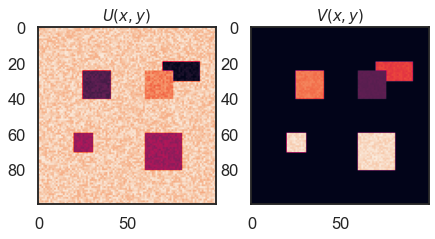

In [11]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(7,7))
ax1.imshow(u[:,:,0]); plt.title("$U(x,y)$",fontsize=15); ax1.set_title("$U(x,y)$",fontsize=15)
ax2.imshow(v[:,:,0]); plt.title("$V(x,y)$",fontsize=15); ax2.set_title("$V(x,y)$",fontsize=15);

Approximating the laplacian of the grid with the `skimage.filters.laplace` function. This filter is commonly used for edge detection.

In [12]:
def evolve(u,v,F,k,Du,Dv):
    for i in range(N-1):
        Lu = -ski.filters.laplace(u[:,:,i]) #applying laplacian filter (approximates laplacian)
        Lv = -ski.filters.laplace(v[:,:,i]) #applying laplacian filter (approximates laplacian)
        u[:,:,i+1] += u[:,:,i]-(u[:,:,i]*(v[:,:,i]**2))+(F*(1-u[:,:,i]))+(Du*Lu)
        v[:,:,i+1] += v[:,:,i]+(u[:,:,i]*(v[:,:,i]**2))-((F+k)*v[:,:,i])+(Dv*Lv)
    return u,v

In [13]:
u,v = evolve(u,v,F,k,Du,Dv)

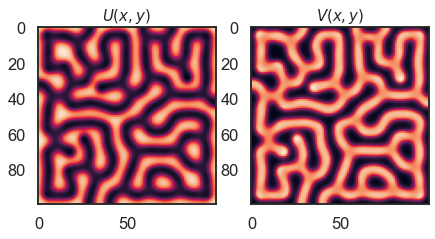

In [14]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(7,7))
ax1.imshow(u[:,:,N-1]); plt.title("$U(x,y)$",fontsize=15); ax1.set_title("$U(x,y)$",fontsize=15)
ax2.imshow(v[:,:,N-1]); plt.title("$V(x,y)$",fontsize=15); ax2.set_title("$V(x,y)$",fontsize=15);

In [15]:
def imager(u,v):
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(8,4.5))
    camera = Camera(fig)
    for i in np.arange(0,N,75):
        ax1.imshow(u[:,:,i]); ax1.set_title("$U(x,y)$",fontsize=15)
        ax2.imshow(v[:,:,i]); ax2.set_title("$V(x,y)$",fontsize=15)
        camera.snap()
    plt.close()
    return camera

In [16]:
camera = imager(u,v)

In [17]:
animation = camera.animate()
#animation.save("turing_diffusion_stripes.gif",writer = 'imagemagick',fps = 10,dpi=300)
animation

# Fun with Gray-Scott

The Gray-Scott model can generate a variety of realistic patterns under different values of *F* and *k* as shown by John Pearson in his [1993 paper](10.1126/science.261.5118.189).

## Bacterial Patterns

In [18]:
F = 0.06 #dimensionless parameter
k = 0.062 #dimensionless paraemeter
Du = 0.10
Dv = 0.06

In [19]:
u,v = initialize(N,gsize)
u,v = evolve(u,v,F,k,Du,Dv)

In [20]:
camera = imager(u,v)

In [21]:
animation = camera.animate()
#animation.save("turing_diffusion_bacterial_patterns.gif",writer = 'imagemagick',fps = 10,dpi=300)
animation

## Spiral Patterns

In [22]:
F = 0.02 #dimensionless parameter
k = 0.05 #dimensionless paraemeter
Du = 0.10
Dv = 0.06

In [23]:
u,v = initialize(N,gsize)
u,v = evolve(u,v,F,k,Du,Dv)

In [24]:
camera = imager(u,v)

In [25]:
animation = camera.animate()
#animation.save("turing_diffusion_spiral_patterns.gif",writer = 'imagemagick',fps = 10,dpi=300)
animation